# Computer Vision - Face Detection

## With OpenCV

### Loading the image

In [1]:
import cv2
from google.colab import files
from google.colab.patches import cv2_imshow
import dlib

In [ ]:
files.upload()

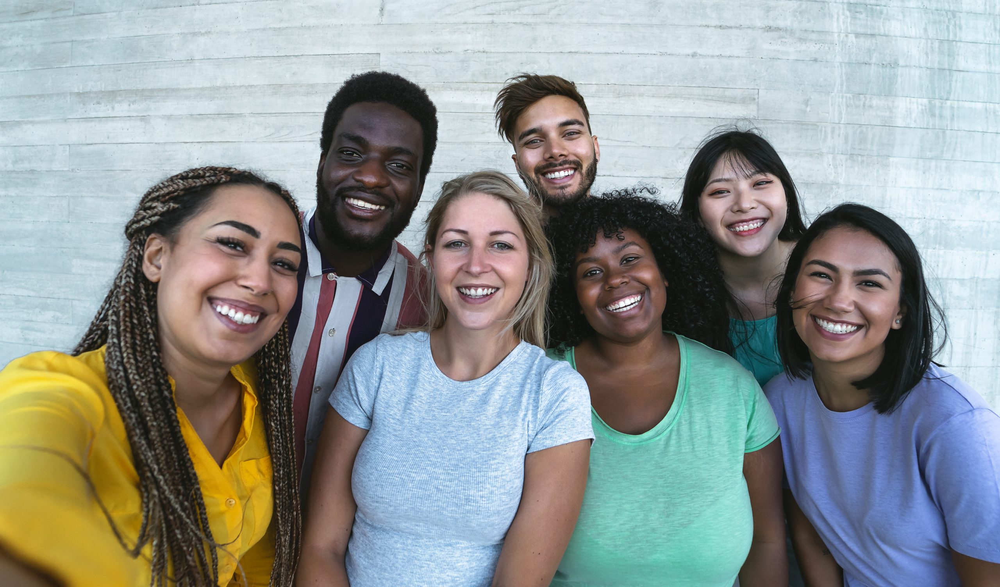

In [3]:

# Assigning the image to a variable
image = cv2.imread('/content/GettyImages-1285126883-scaled.jpg')

# Displaying the image
cv2_imshow(image)

In [4]:
def resized_grayscale(image):
  # Resizing the image to due large shape
  image_resized = cv2.resize(src = image,
                            dsize = (378, 228))

  # Converting the image to greyscale for less pixels
  image_resized_greyscaled = cv2.cvtColor(image_resized, cv2.COLOR_BGR2GRAY)

  return image_resized_greyscaled

In [5]:
grey_image = resized_grayscale(image)
resized_image = cv2.resize(src = image, dsize = (378, 228))

### Detecting Faces

In [ ]:
# Importing face detector xml from opencv
files.upload()

In [7]:
# Loading cascade xml files as Cascade Classifier
face_detector = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')

# Creating a variable for detections
detections = face_detector.detectMultiScale(grey_image)

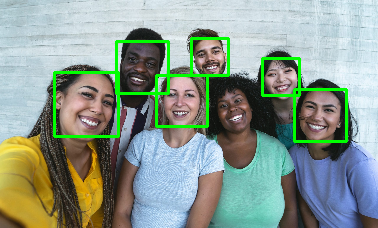

In [8]:
# Drawing the rectangle on the image where the detections are corresponding
for (x, y, w, h) in detections:
  cv2.rectangle(resized_image, (x, y), (x + w, y + h), color = (0, 255, 0), thickness = 2)
cv2_imshow(resized_image)

There is a missing case where a face is not detected!!!

### Adjusting the parameters

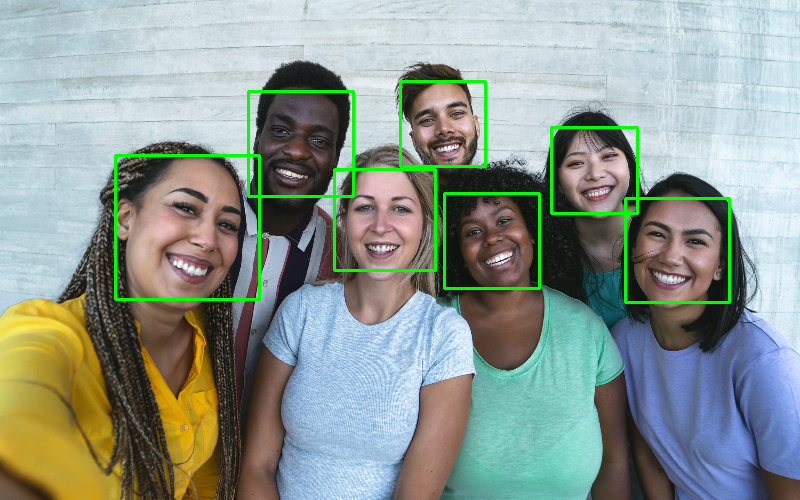

In [9]:
image = cv2.imread('/content/GettyImages-1285126883-scaled.jpg')
resized_image = cv2.resize(src = image, dsize = (800, 500))
greyed_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
face_detector = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')
detections = face_detector.detectMultiScale(greyed_image, scaleFactor = 1.06, minNeighbors = 6, minSize = (70, 70))
for (x, y, w, h) in detections:
  cv2.rectangle(resized_image, (x, y), (x + w, y + h), color = (0, 255, 0), thickness = 2)
cv2_imshow(resized_image)

Now our detection is correct 🙌

### Loading a different image to check again

In [ ]:
files.upload()

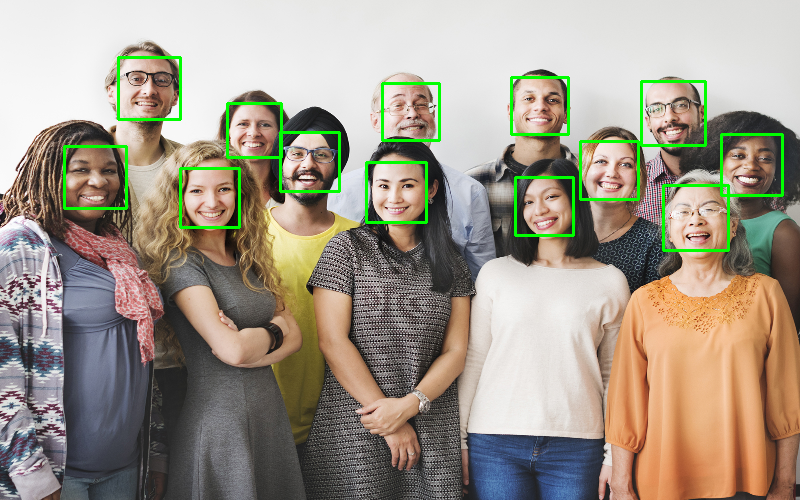

In [11]:
image = cv2.imread('/content/banner-diverse-group-of-people-2.jpg')
resized_image = cv2.resize(src = image, dsize = (800, 500))
greyed_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
face_detector = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')
detections = face_detector.detectMultiScale(greyed_image,
                                            scaleFactor = 1.09,
                                            minNeighbors = 3,
                                            minSize = (30, 30),
                                            maxSize = (70, 70))
for (x, y, w, h) in detections:
  cv2.rectangle(resized_image, (x, y), (x + w, y + h), color = (0, 255, 0), thickness = 2)
cv2_imshow(resized_image)

With little tweaking we were able to find the faces!!!

### Detecting Eyes

In [ ]:
files.upload()

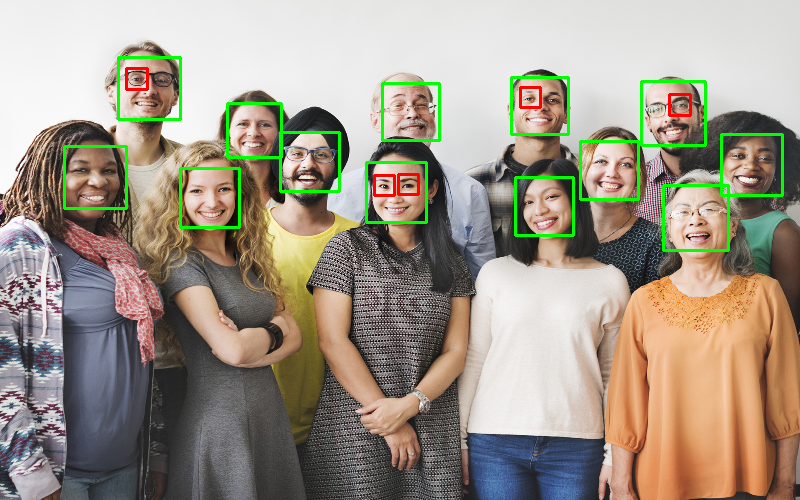

In [25]:
# Creating a eye detector using the cascade xml
image = cv2.imread('/content/banner-diverse-group-of-people-2.jpg')
resized_image = cv2.resize(image, (800, 500))
greyed_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)

face_detector = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')
face_detections = face_detector.detectMultiScale(greyed_image,
                                                 scaleFactor = 1.09,
                                                 minNeighbors = 3,
                                                 minSize = (30, 30),
                                                 maxSize = (70, 70))
for (x, y, w, h) in face_detections:
  cv2.rectangle(resized_image,
                (x, y),
                (x + w, y + h),
                color = (0, 255, 0),
                thickness = 2)

eye_detector = cv2.CascadeClassifier('/content/haarcascade_eye.xml')
eye_detections = eye_detector.detectMultiScale(greyed_image,
                                               scaleFactor = 1.03,
                                               minNeighbors = 10,
                                               maxSize = (30, 30))
for(x, y, w, h) in eye_detections:
  cv2.rectangle(resized_image,
                (x, y),
                (x + w - 2, y + h - 2),
                color = (0, 0, 255),
                thickness = 2)

cv2_imshow(resized_image)

## Dlib

* Detecting faces with HOG
* Detecting faces with CNN (Convolutional Neural Networks)
* Haarcascade x HOG x CNN

### Detecting faces with HOG

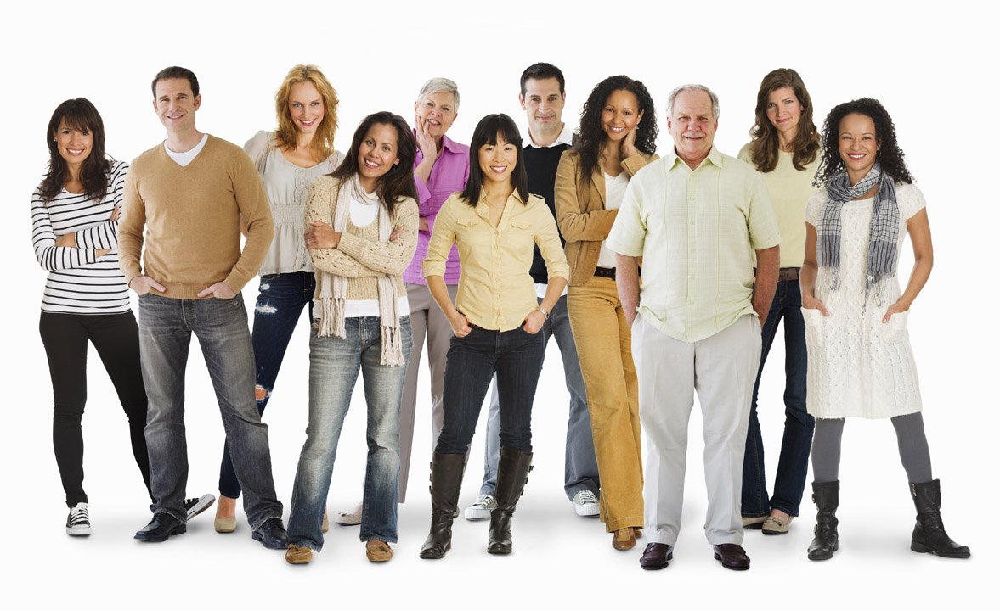

In [13]:
# Importing the image
image = cv2.imread('/content/R (3).jpg')
cv2_imshow(image)

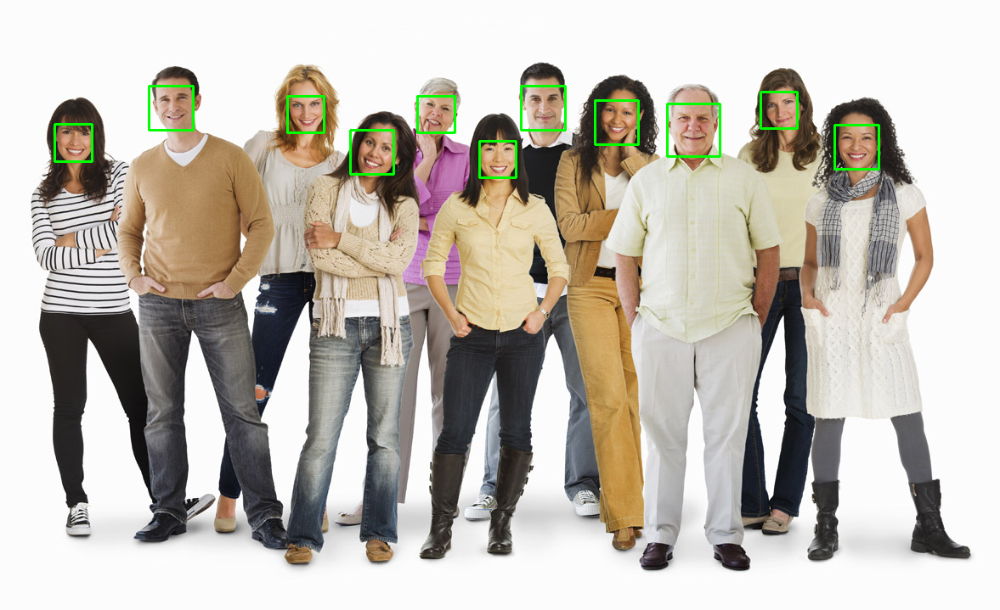

In [16]:
# Assigning the HOG
image = cv2.imread('/content/R (3).jpg')
face_detector = dlib.get_frontal_face_detector()
detections = face_detector(image, 1)
for face in detections:
  l, t, r, b = face.left(), face.top(), face.right(), face.bottom()
  cv2.rectangle(image,
                (l, t),
                (r, b),
                color = (0, 255, 0),
                thickness = 2)
cv2_imshow(image)

### Detecting faces with CNN

In [ ]:
files.upload()

[1.14, 1.13, 1.13, 1.11, 1.1, 1.08, 1.08, 1.08, 1.07, 1.07, 1.07, 1.06, 1.06, 1.05, 1.04, 1.03, 0.58]


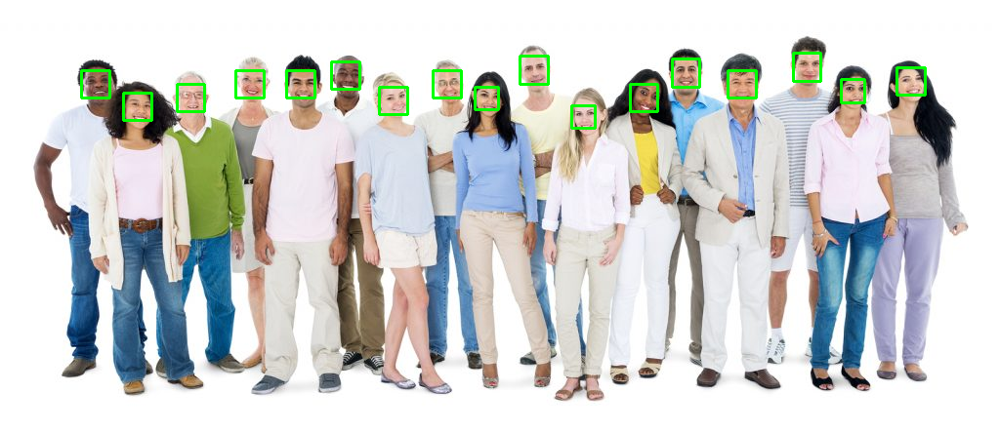

In [16]:
image = cv2.imread('/content/bigstock-Group-of-diverse-people-215128027-1024x443.jpg')
cnn_detector = dlib.cnn_face_detection_model_v1('/content/mmod_human_face_detector.dat')
detections = cnn_detector(image, 2)
list_c = []
for face in detections:
  l, t, r, b, c = face.rect.left(), face.rect.top(), face.rect.right(), face.rect.bottom(), face.confidence
  list_c.append(round(c, 2))
  cv2.rectangle(image,
                (l, t),
                (r, b),
                (0, 255, 0),
                2)
print(list_c)
cv2_imshow(image)

### Harcascade x HOG x CNN

In [ ]:
files.upload()

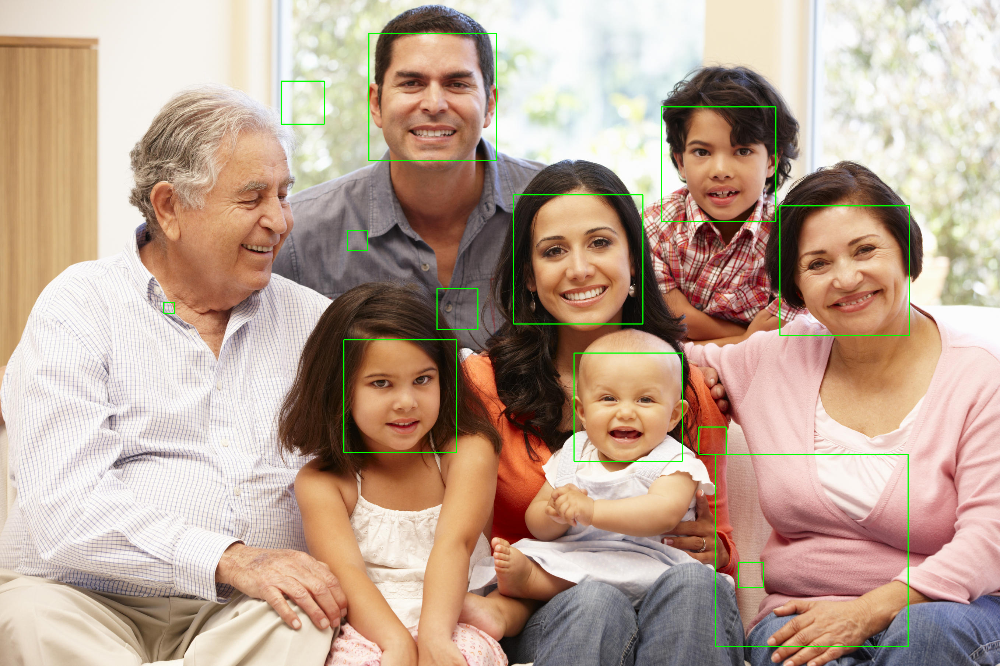

In [4]:
# Haarcascade
image = cv2.imread('/content/R (4).jpg')
grey_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
face_detector = cv2.CascadeClassifier('/content/haarcascade_frontalface_default.xml')
detections = face_detector.detectMultiScale(grey_image, scaleFactor = 1.09)
for (x, y, w, h) in detections:
  cv2.rectangle(image, (x, y),
                (x + w, y + h),
                (0, 255, 0), 2)
cv2_imshow(image)

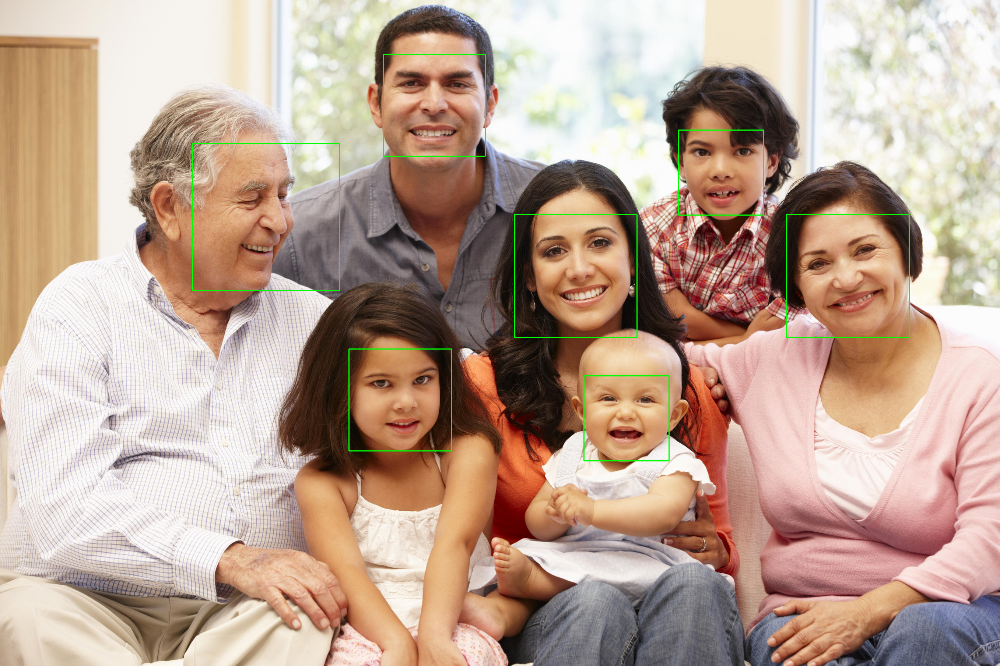

In [5]:
# HOG
image = cv2.imread('/content/R (4).jpg')
face_detector = dlib.get_frontal_face_detector()
detections = face_detector(image, 2)
for face in detections:
  l, r, t, b = face.left(), face.right(), face.top(), face.bottom()
  cv2.rectangle(image, (l, t),
                (r, b), (0, 255, 0), 2)
cv2_imshow(image)

In [ ]:
# CNN
image = cv2.imread('/content/R (4).jpg')
face_detector = dlib.cnn_face_detection_model_v1('/content/mmod_human_face_detector.dat')
detections = face_detector(image, 2)
list_c = []
for face in detections:
  l, r, t, b, c = face.rect.left(), face.rect.right(), face.rect.top(), face.rect.bottom(), face.confidence
  list_c.append(round(c, 2))
  cv2.rectangle(image, (l, t),
                (r, b), (0, 255, 0), 2)
print(list_c)
cv2_imshow(image)

As a result based on the above image we find HOG to find face more accuractely